<a href="https://colab.research.google.com/github/NamLam-L/Transfer-Learning-model/blob/main/Dl4_2_ResNet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Mount drive 
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import keras
keras.__version__


'2.7.0'

In [ ]:
path = "//content//gdrive//MyDrive//ML"
import os
os.path.isdir(path)

True

In [ ]:
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from keras import Model, layers 
from keras.models import load_model, model_from_json
import tensorflow as tf
import PIL

In [ ]:
%cd /content/gdrive/"My Drive"/"ML"/"Alien and Predator"
!unzip 'Alien vs Predator images.zip'

/content/gdrive/My Drive/ML/Alien and Predator
Archive:  Alien vs Predator images.zip
replace alien_vs_predator_thumbnails/data/train/alien/0.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: alien_vs_predator_thumbnails/data/train/alien/0.jpg  
replace alien_vs_predator_thumbnails/data/train/alien/1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: alien_vs_predator_thumbnails/data/train/alien/1.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/10.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/100.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/101.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/102.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/103.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/104.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/105.jpg  
  inflating: alien_vs_predator_thumbnails/data/train/alien/106.jpg  
  inflating: alien_vs_preda

In [ ]:
input_path = path + "/Alien and Predator/data/"
os.path.isdir(input_path)

True

In [ ]:
print("total train alien images: ", len(os.listdir(input_path + 'train/alien')))
print("total train predators images: ", len(os.listdir(input_path + 'train/predator')))
print("total validation predators images: ", len(os.listdir(input_path + 'validation/predator')))
print("total validation alien images: ", len(os.listdir(input_path + 'validation/alien')))

total train alien images:  347
total train predators images:  347
total validation predators images:  100
total validation alien images:  100


In [ ]:
datagen = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 10,
    horizontal_flip = True,
    zoom_range = 0.2,
    preprocessing_function = preprocess_input
    )
train_generator = datagen.flow_from_directory(input_path + 'train',
                                                    batch_size = 32, 
                                                    class_mode = 'binary',
                                                  target_size = (224,224))

validation_generator = datagen.flow_from_directory(
    input_path + 'validation',
                                                    shuffle = False, 
                                                    class_mode = 'binary',
                                                  target_size = (224,224)
)

# plt.imshow(train_generator[1][0][0])
# plt.show()
# train_generator[1][0][0]

Found 694 images belonging to 2 classes.
Found 200 images belonging to 2 classes.


In [ ]:
conv_base = ResNet50(include_top= False,
                     weights = 'imagenet')
for layer in conv_base.layers:
  layer.trainable = False


In [ ]:
x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128,activation='relu')(x)
predictions = layers.Dense(2, activation='softmax')(x)
model = Model(conv_base.input, predictions)

In [ ]:
import tensorflow as tf 
optimizer =tf.optimizers.Adam()
model.compile(loss = 'sparse_categorical_crossentropy',
              optimizer = optimizer,
              metrics = ['accuracy'])


In [ ]:
history = model.fit_generator(generator= train_generator,
                              steps_per_epoch = 347//32,
                              epochs = 5,
                              validation_data = validation_generator,
                              validation_steps = 5
                              )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


Epoch 1/15
10/10 [==============================] - 92s 10s/step - loss: 0.6121 - accuracy: 0.6258 - val_loss: 0.6295 - val_accuracy: 0.6150
Epoch 2/15
10/10 [==============================] - 101s 11s/step - loss: 0.6121 - accuracy: 0.6313 - val_loss: 0.6301 - val_accuracy: 0.6300
Epoch 3/15
10/10 [==============================] - 103s 11s/step - loss: 0.6018 - accuracy: 0.6719 - val_loss: 0.5785 - val_accuracy: 0.7200
Epoch 4/15
10/10 [==============================] - 99s 10s/step - loss: 0.6044 - accuracy: 0.6469 - val_loss: 0.6118 - val_accuracy: 0.6500
Epoch 5/15
10/10 [==============================] - 93s 10s/step - loss: 0.5771 - accuracy: 0.6938 - val_loss: 0.5786 - val_accuracy: 0.7100
Epoch 6/15
10/10 [==============================] - 99s 10s/step - loss: 0.5723 - accuracy: 0.7161 - val_loss: 0.5977 - val_accuracy: 0.7050
Epoch 7/15
10/10 [==============================] - 100s 10s/step - loss: 0.5689 - accuracy: 0.7000 - val_loss: 0.5673 - val_accuracy: 0.7050
Epoch 8/15

In [ ]:
%tensorboard --history logs

UsageError: Line magic function `%tensorboard` not found.


In [ ]:
path2 = "//content//gdrive//Shared drives//AI(everythings)//Transfer Learning Model"
os.path.isdir(path2)

True

In [ ]:
model.save(path2+ "Predator and Alien.h5")

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


In [ ]:
model = load_model (path2 +"Predator and Alien.h5" )

In [ ]:
validation_img_paths = ["validation/alien/11.jpg", "validation/alien/22.jpg", "validation/predator/33.jpg"]

img_list = [Image.open(input_path + image_path) for image_path in validation_img_paths]

In [ ]:
img_list

[<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=273x184 at 0x7EFD6DCCD8D0>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=309x163 at 0x7EFD6DCAAAD0>,
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=275x183 at 0x7EFD73A5F5D0>]

In [ ]:
validation_batch = np.stack([preprocess_input(np.array(img.resize((224,224)))) for img in img_list])

In [ ]:
pre_probs = model.predict(validation_batch)
pre_probs

array([[1.0000000e+00, 4.7693139e-15],
       [1.0000000e+00, 4.7408427e-12],
       [1.0000000e+00, 6.0019487e-14]], dtype=float32)

In [ ]:
test_size = 30;
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
probabilities = model.predict(validation_generator, test_size)

index: 0


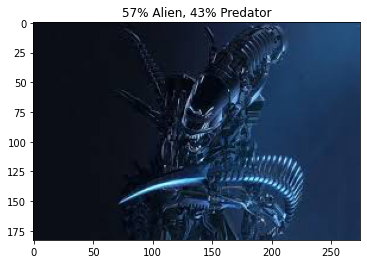

index: 1


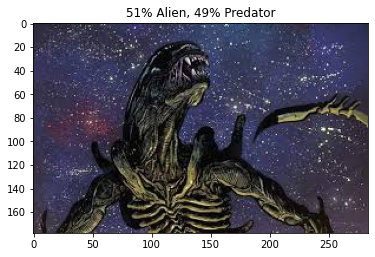

index: 2


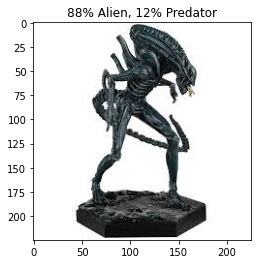

index: 3


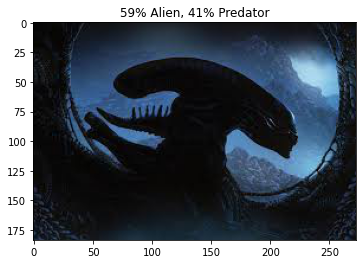

index: 4


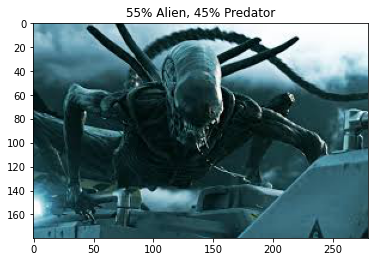

index: 5


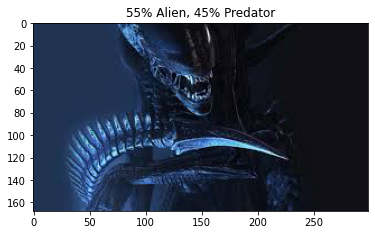

index: 6


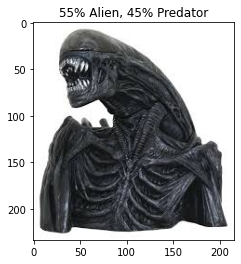

index: 7


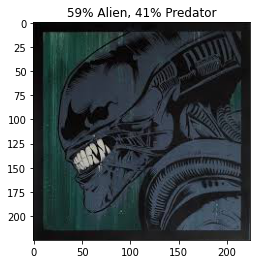

index: 8


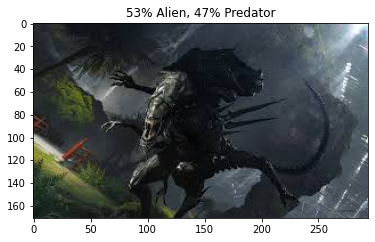

index: 9


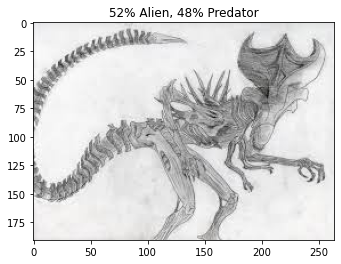

index: 10


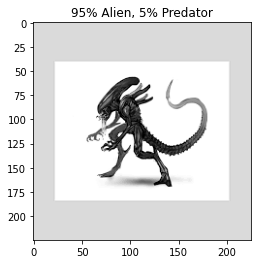

index: 11


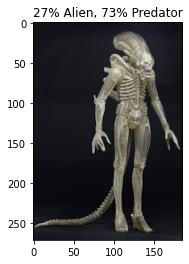

index: 12


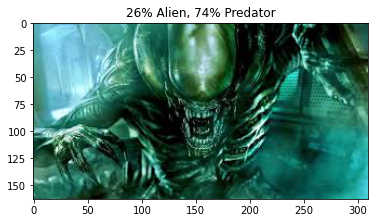

index: 13


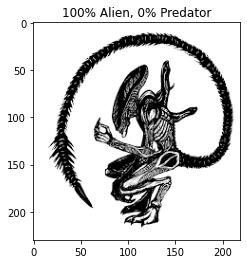

index: 14


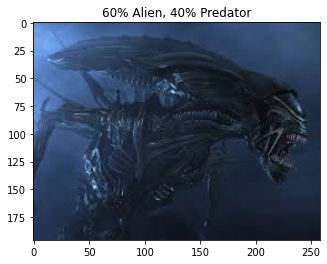

index: 15


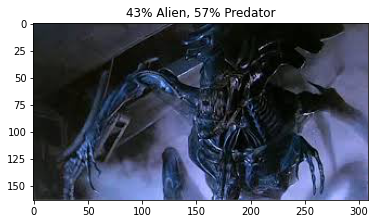

index: 16


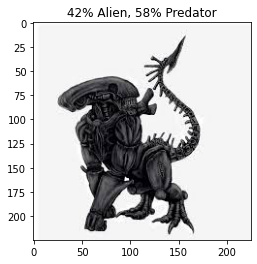

index: 17


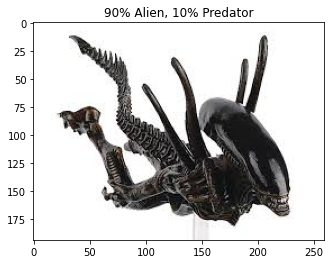

index: 18


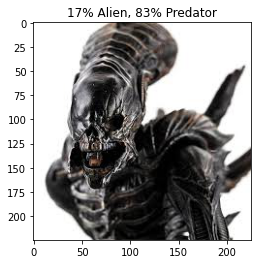

index: 19


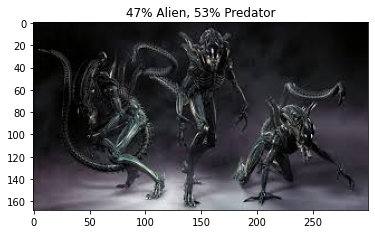

index: 20


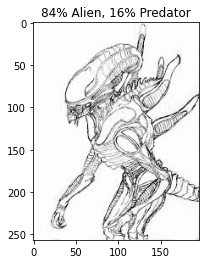

index: 21


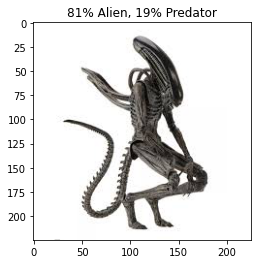

index: 22


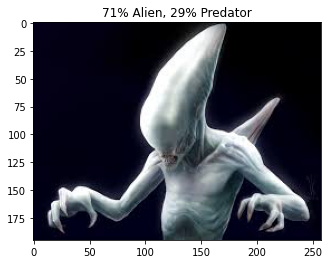

index: 23


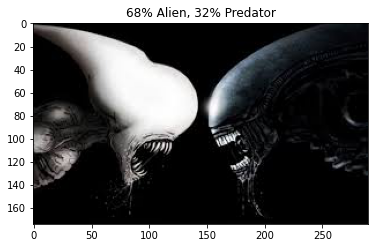

index: 24


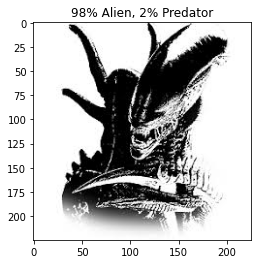

index: 25


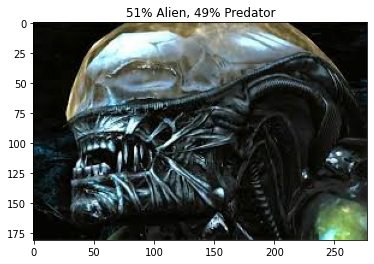

index: 26


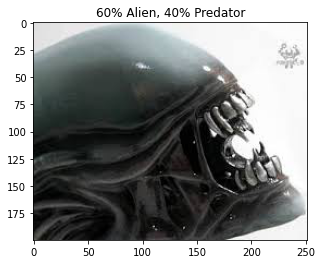

index: 27


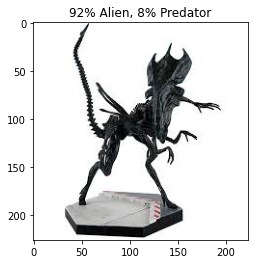

index: 28


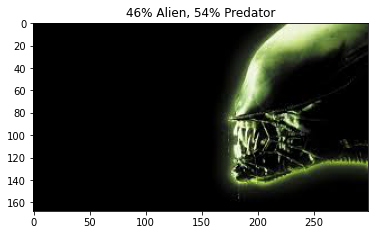

index: 29


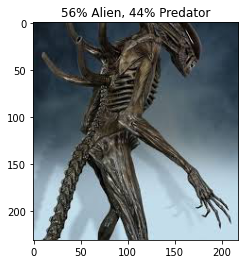

index: 30


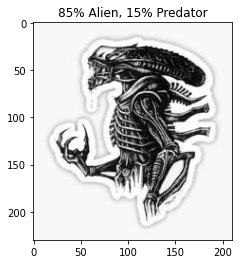

index: 31


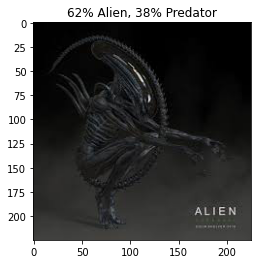

index: 32


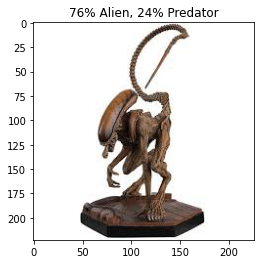

index: 33


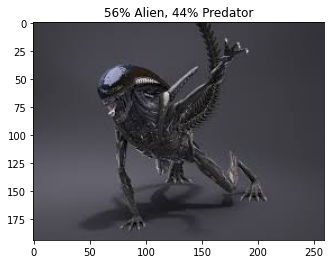

index: 34


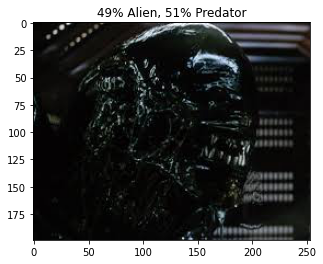

index: 35


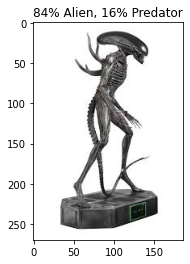

index: 36


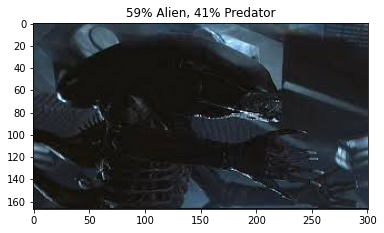

index: 37


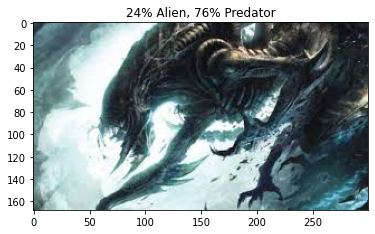

index: 38


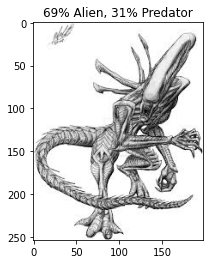

index: 39


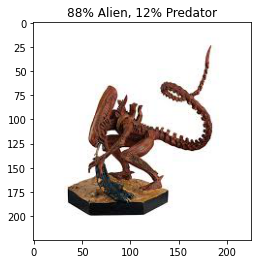

index: 40


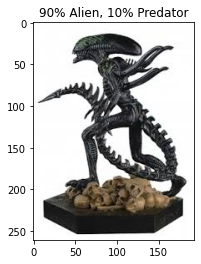

index: 41


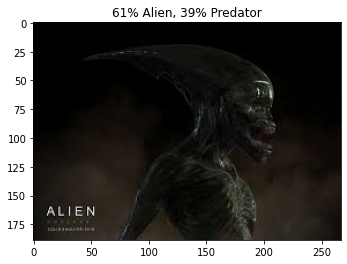

index: 42


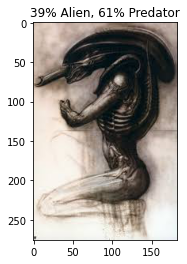

index: 43


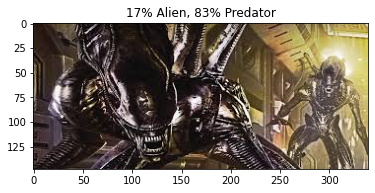

index: 44


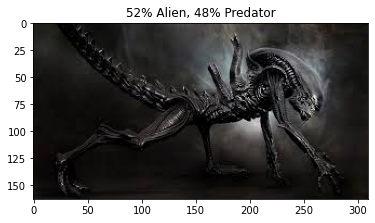

index: 45


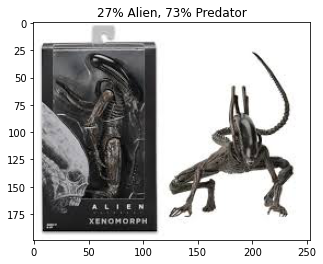

index: 46


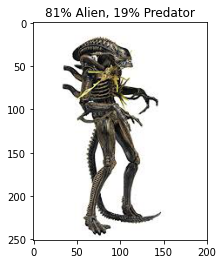

index: 47


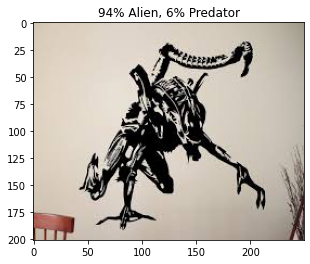

index: 48


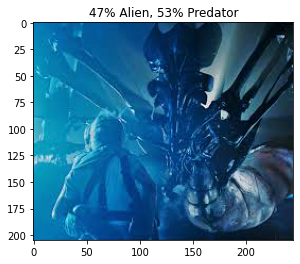

index: 49


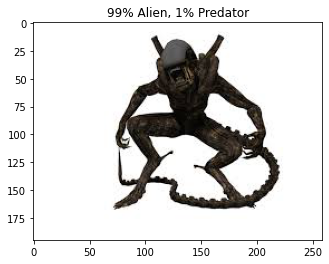

index: 50


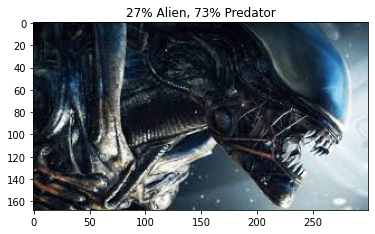

index: 51


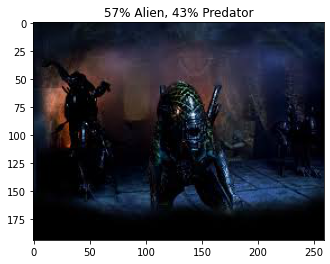

index: 52


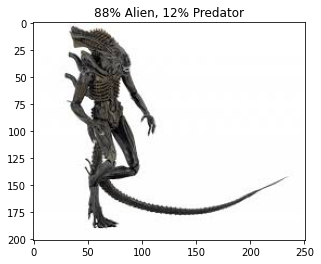

index: 53


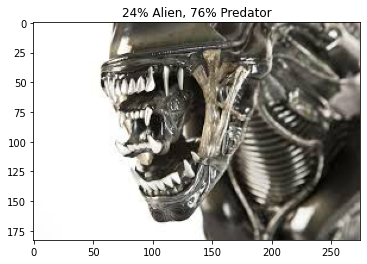

index: 54


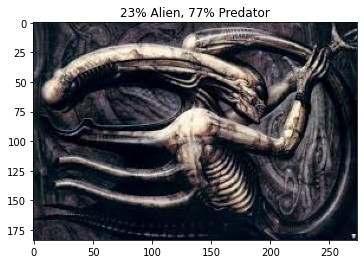

index: 55


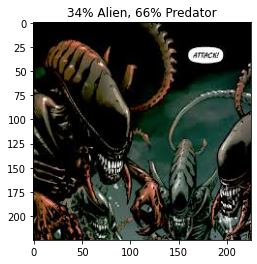

index: 56


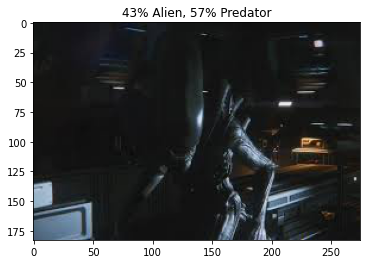

index: 57


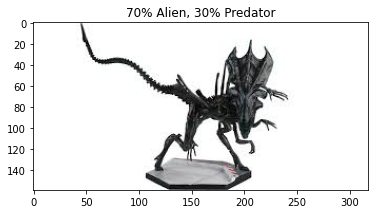

index: 58


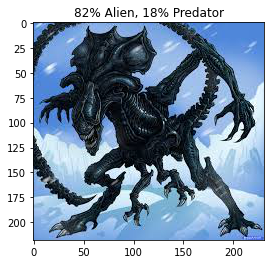

index: 59


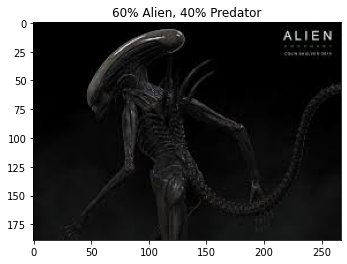

index: 60


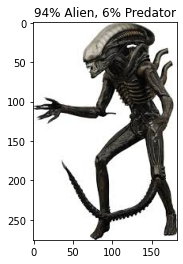

index: 61


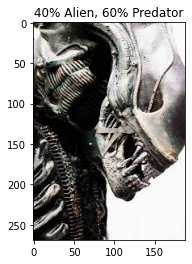

index: 62


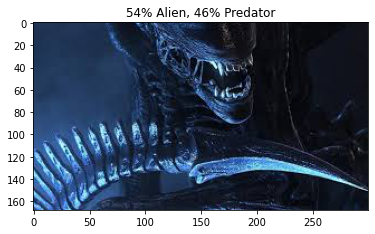

index: 63


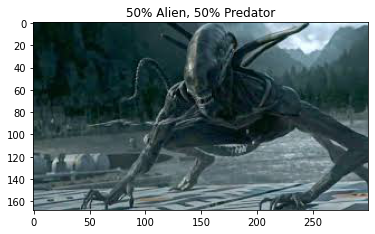

index: 64


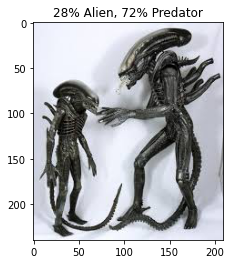

index: 65


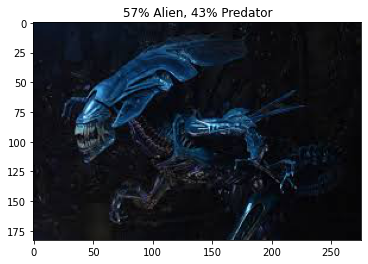

index: 66


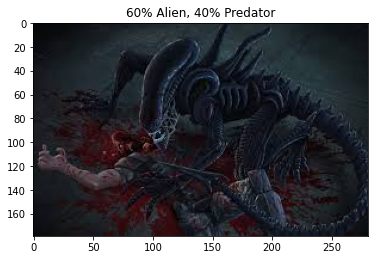

index: 67


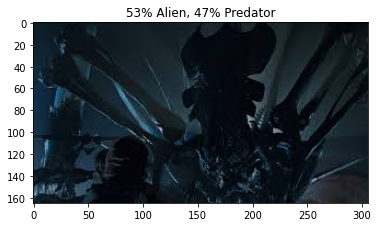

index: 68


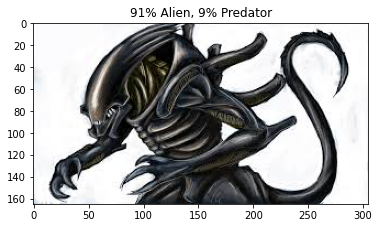

index: 69


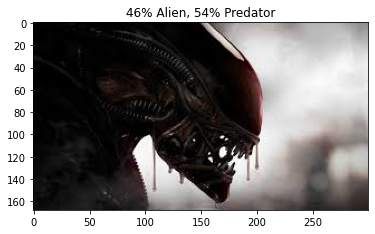

index: 70


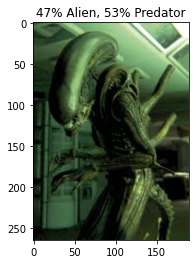

index: 71


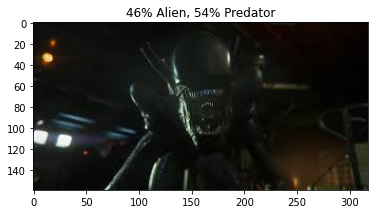

index: 72


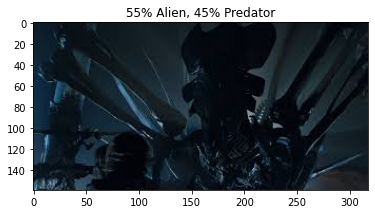

index: 73


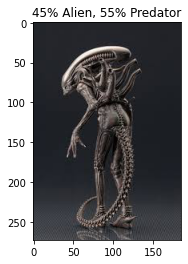

index: 74


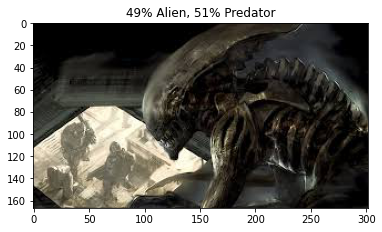

index: 75


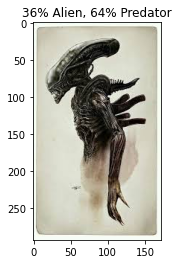

index: 76


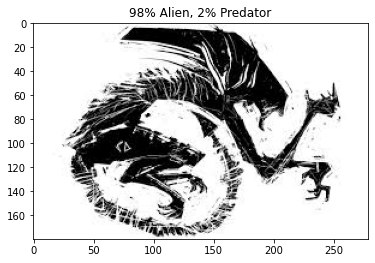

index: 77


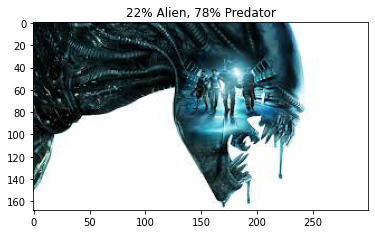

index: 78


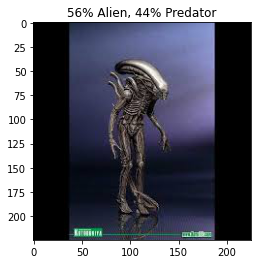

index: 79


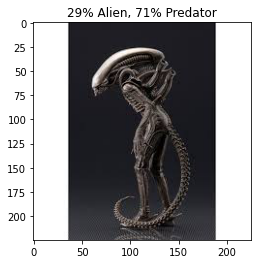

index: 80


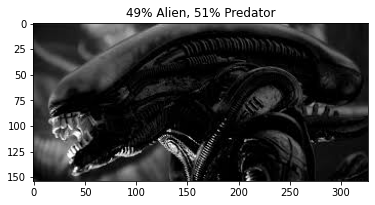

index: 81


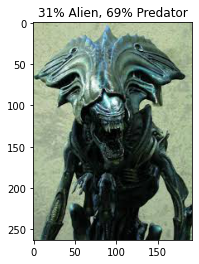

index: 82


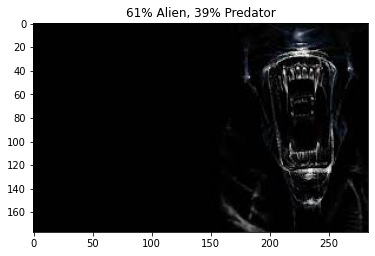

index: 83


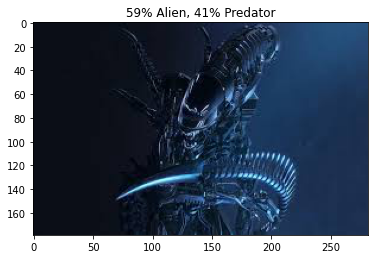

index: 84


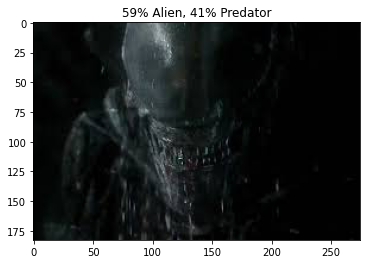

index: 85


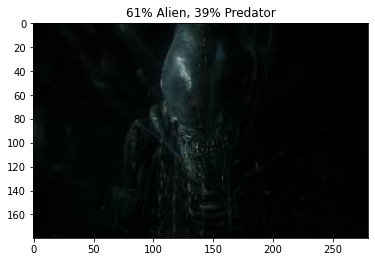

index: 86


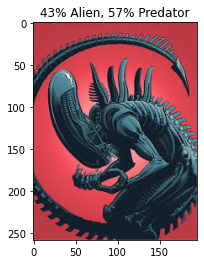

index: 87


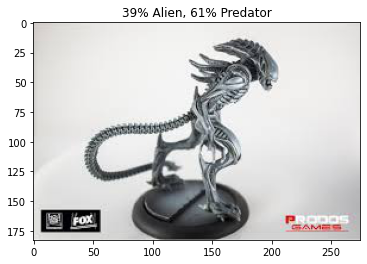

index: 88


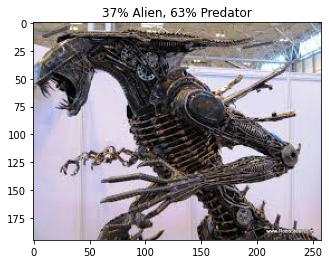

index: 89


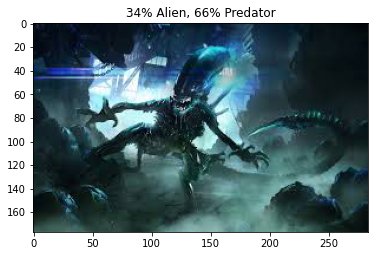

index: 90


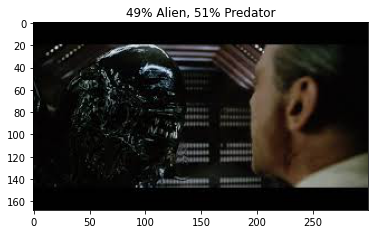

index: 91


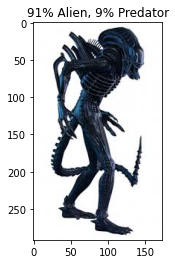

index: 92


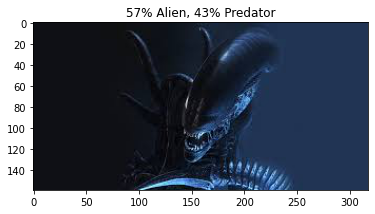

index: 93


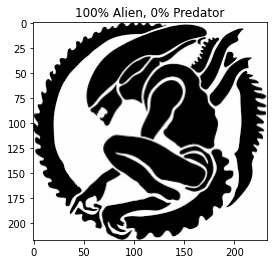

index: 94


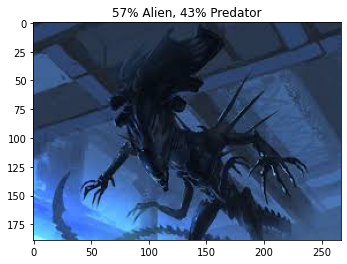

index: 95


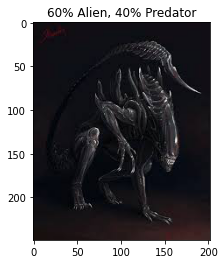

index: 96


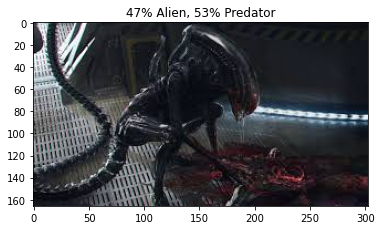

index: 97


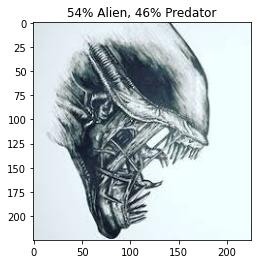

index: 98


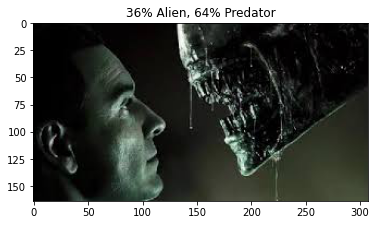

index: 99


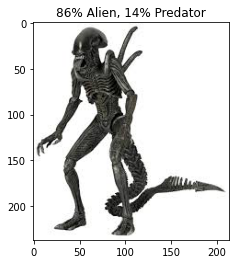

index: 100


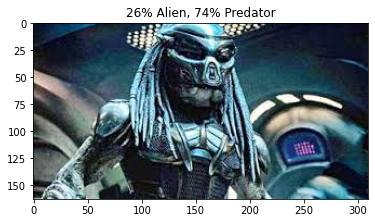

index: 101


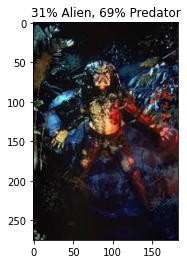

index: 102


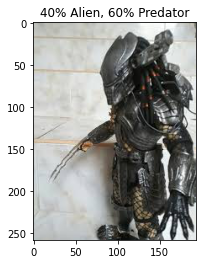

index: 103


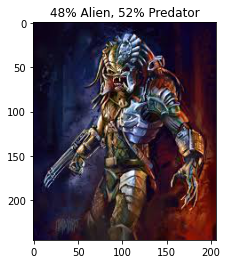

index: 104


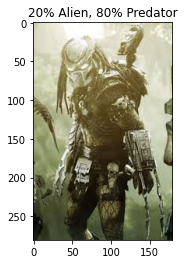

index: 105


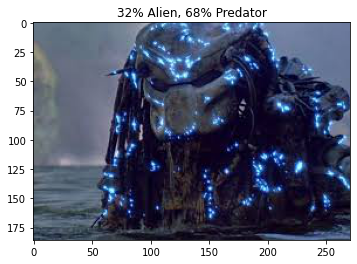

index: 106


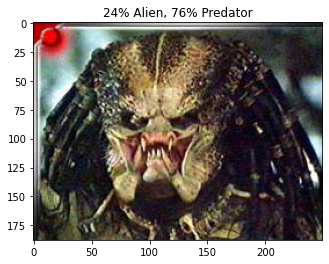

index: 107


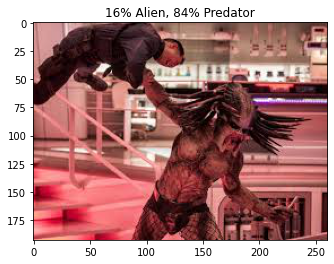

index: 108


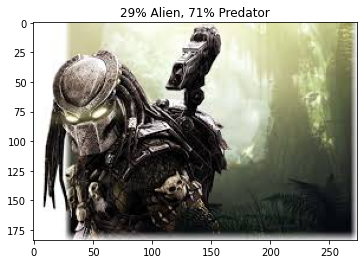

index: 109


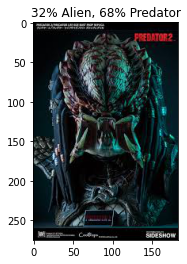

index: 110


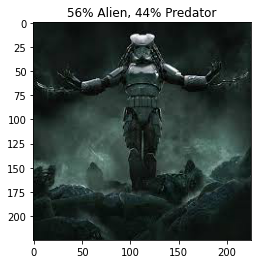

index: 111


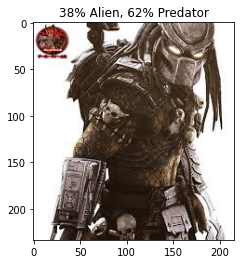

index: 112


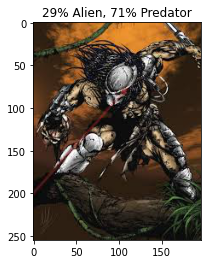

index: 113


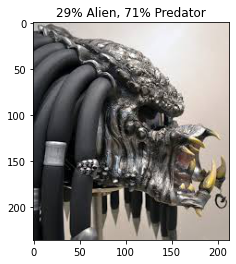

index: 114


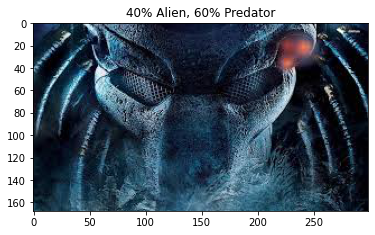

index: 115


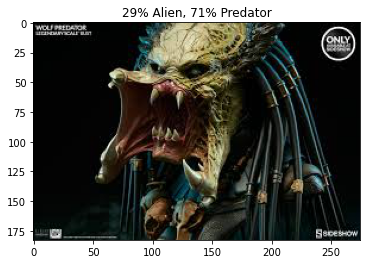

index: 116


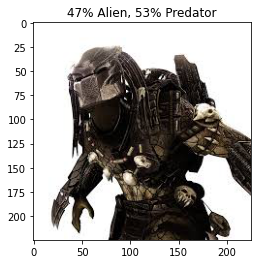

index: 117


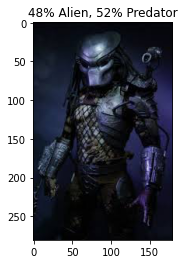

index: 118


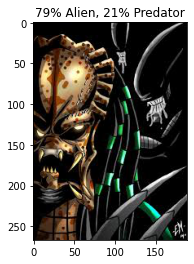

index: 119


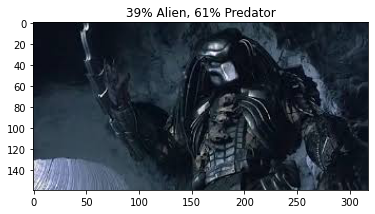

index: 120


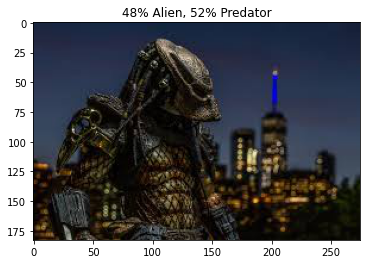

index: 121


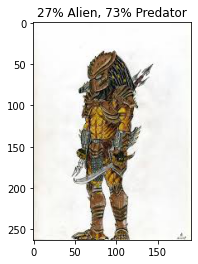

index: 122


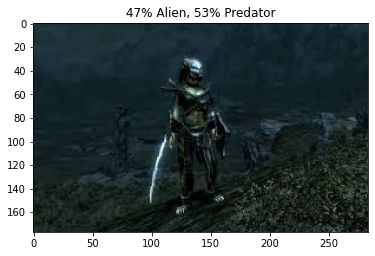

index: 123


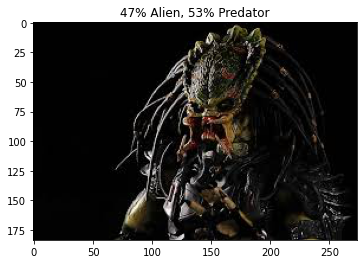

index: 124


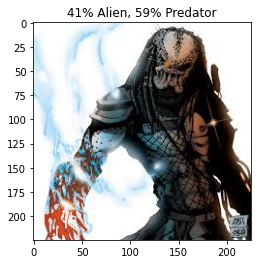

index: 125


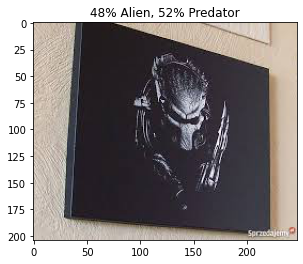

index: 126


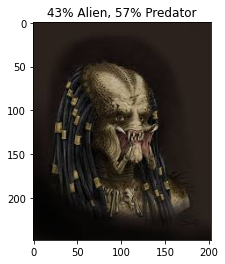

index: 127


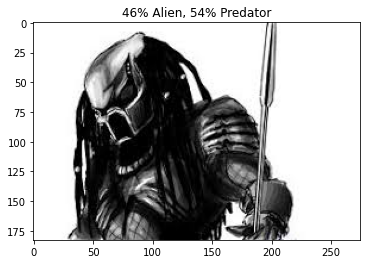

index: 128


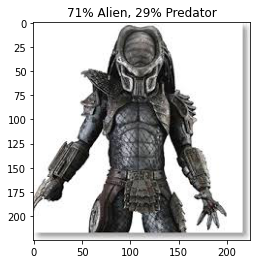

index: 129


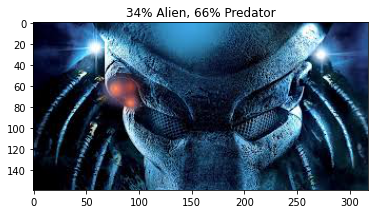

index: 130


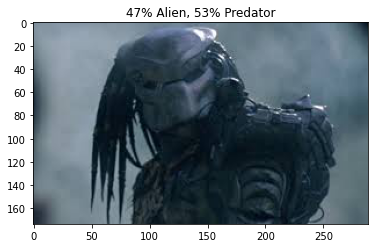

index: 131


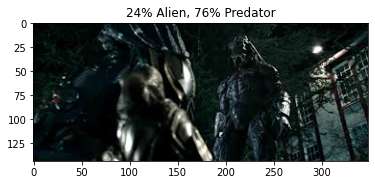

index: 132


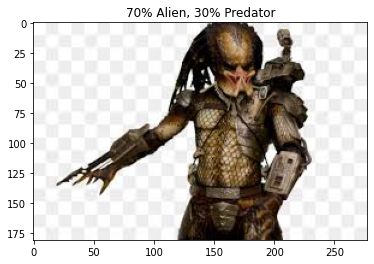

index: 133


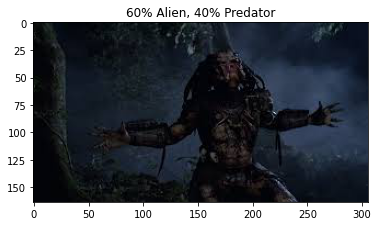

index: 134


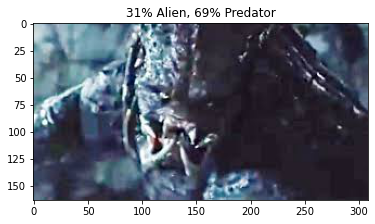

index: 135


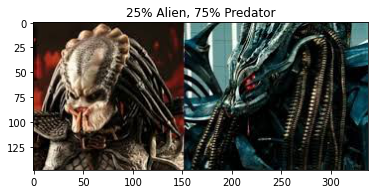

index: 136


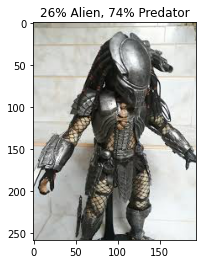

index: 137


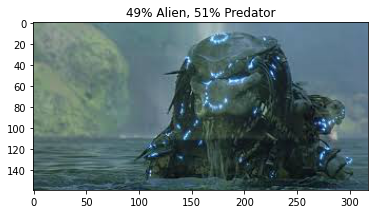

index: 138


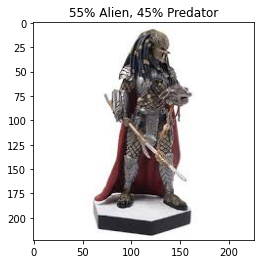

index: 139


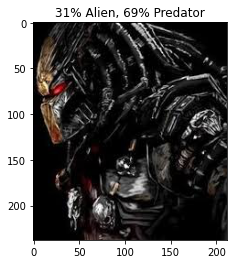

index: 140


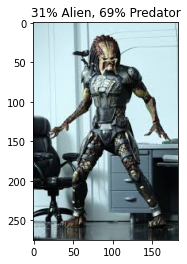

index: 141


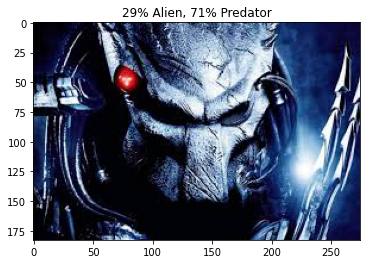

index: 142


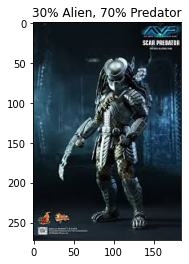

index: 143


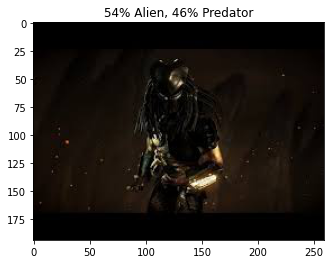

index: 144


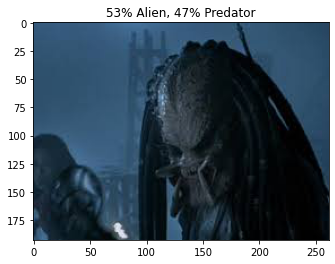

index: 145


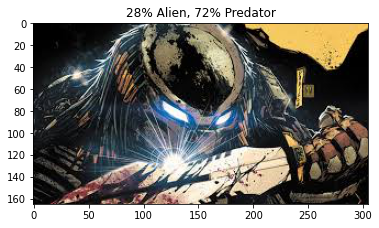

index: 146


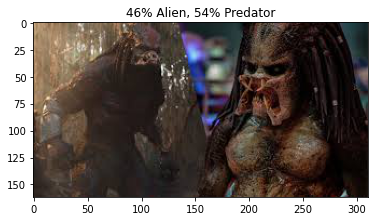

index: 147


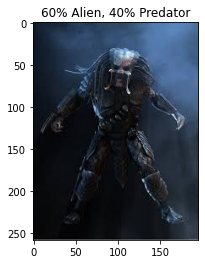

index: 148


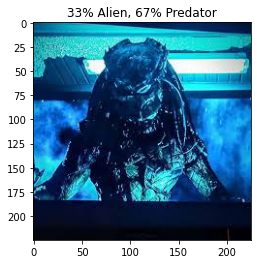

index: 149


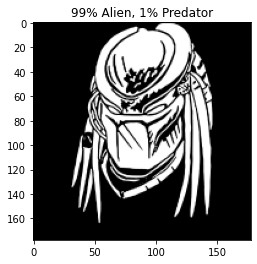

index: 150


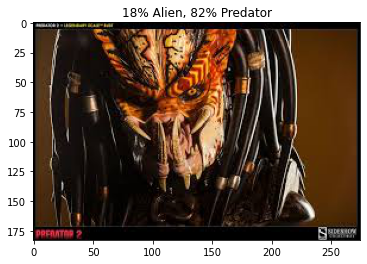

index: 151


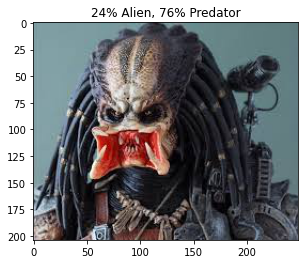

index: 152


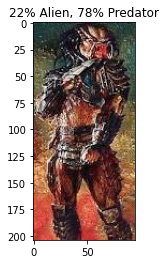

index: 153


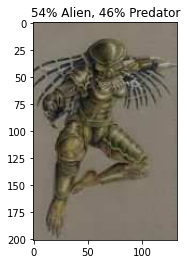

index: 154


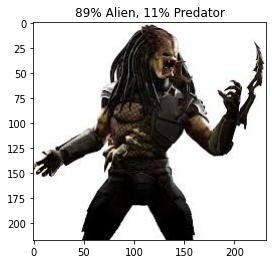

index: 155


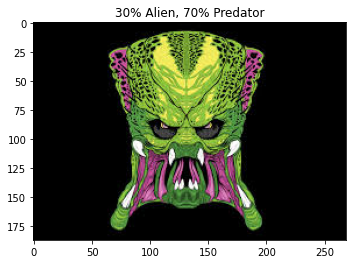

index: 156


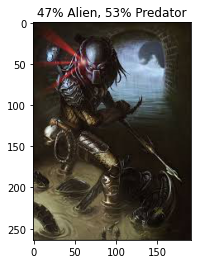

index: 157


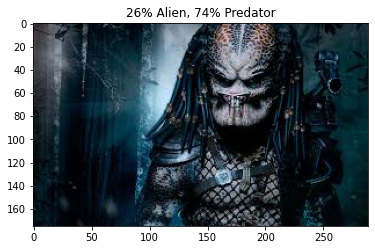

index: 158


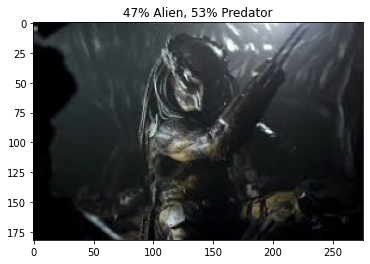

index: 159


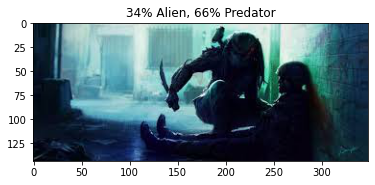

index: 160


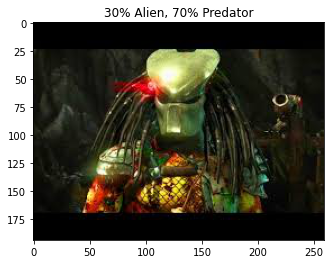

index: 161


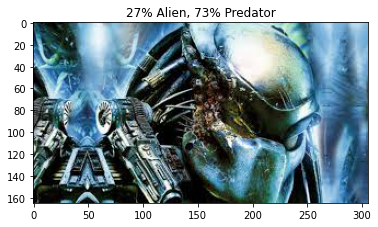

index: 162


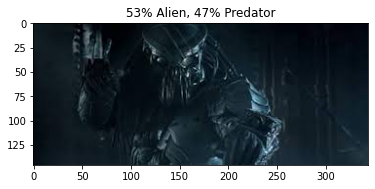

index: 163


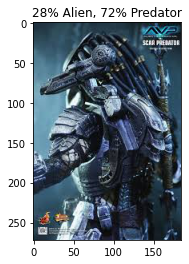

index: 164


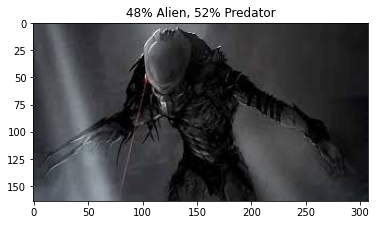

index: 165


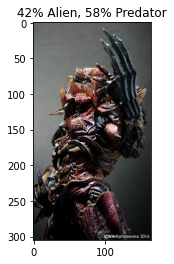

index: 166


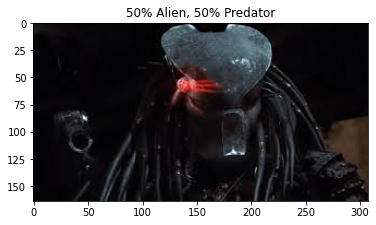

index: 167


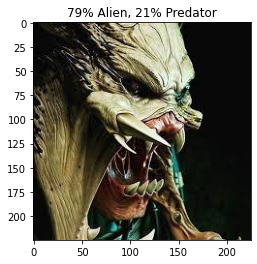

index: 168


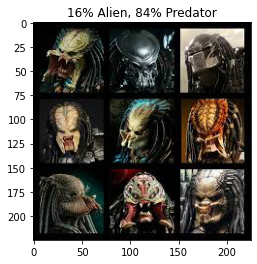

index: 169


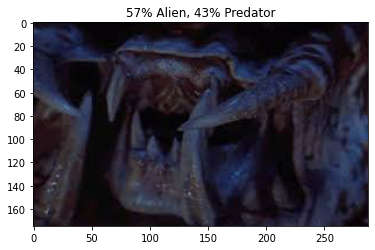

index: 170


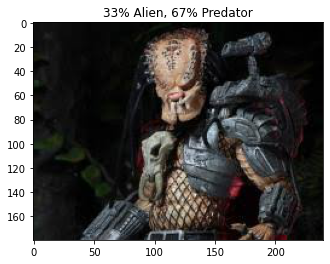

index: 171


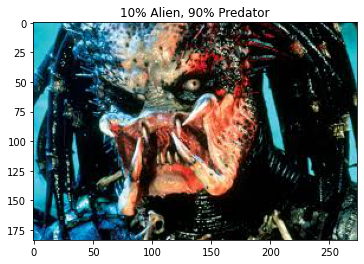

index: 172


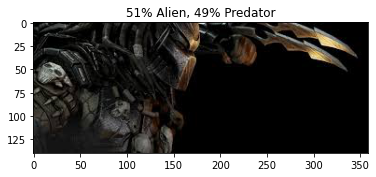

index: 173


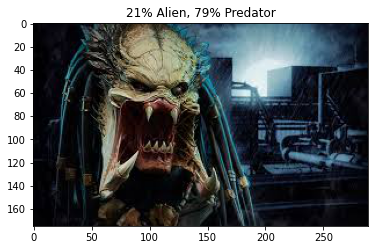

index: 174


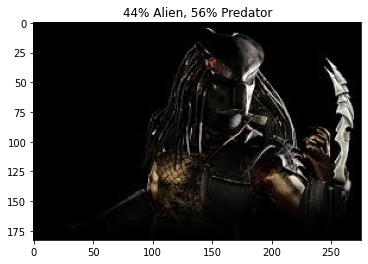

index: 175


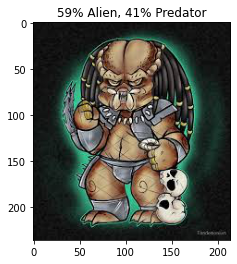

index: 176


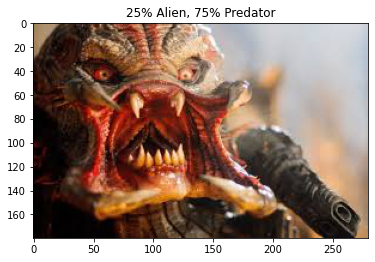

index: 177


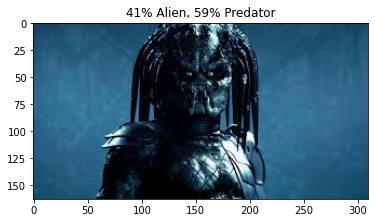

index: 178


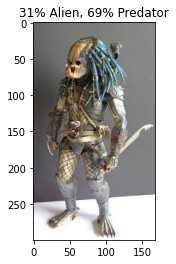

index: 179


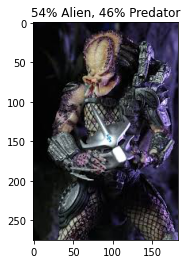

index: 180


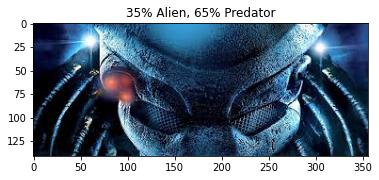

index: 181


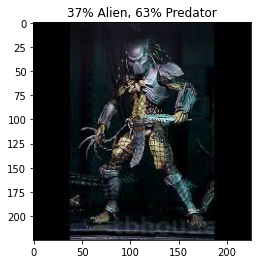

index: 182


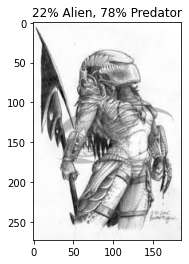

index: 183


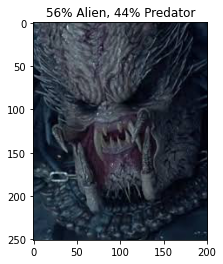

index: 184


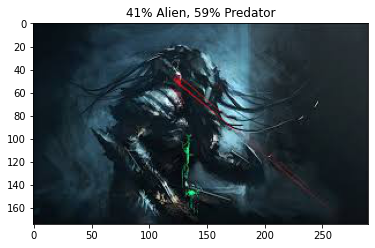

index: 185


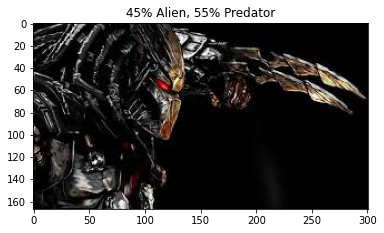

index: 186


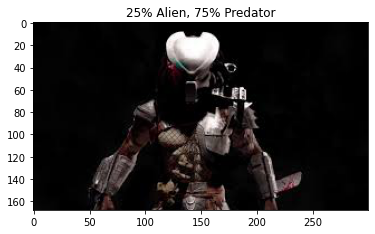

index: 187


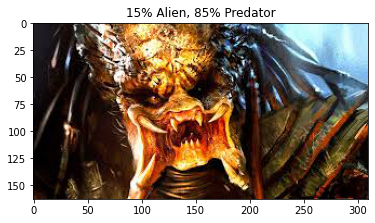

index: 188


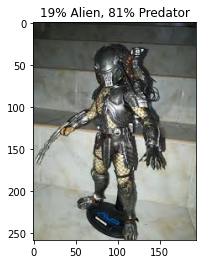

index: 189


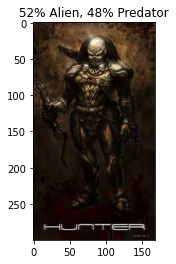

index: 190


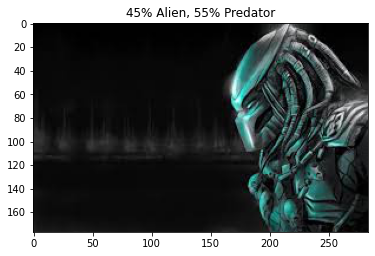

index: 191


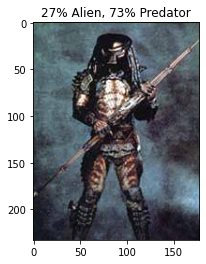

index: 192


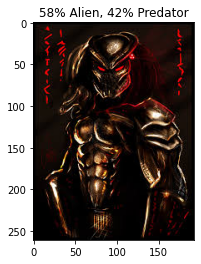

index: 193


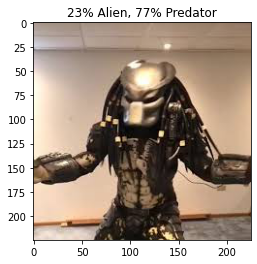

index: 194


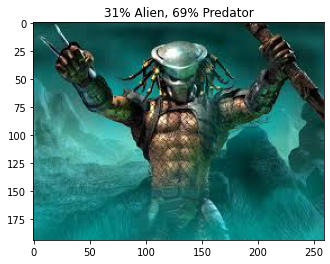

index: 195


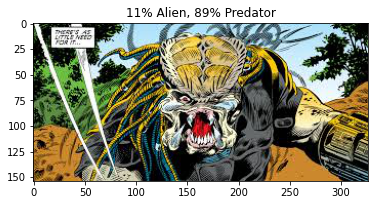

index: 196


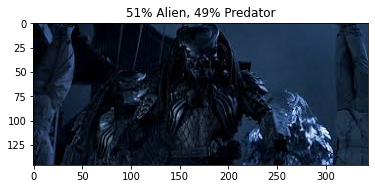

index: 197


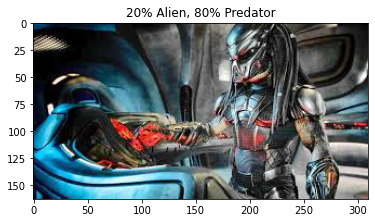

index: 198


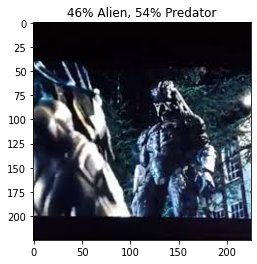

index: 199


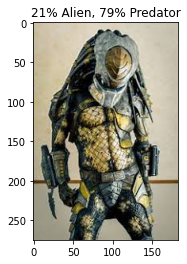

In [ ]:
validation_dir = input_path + 'validation'
for index, probability in enumerate(probabilities):
  print("index:", index)
  # print(" probability", probability[0])
  # print("file_name:", test_generator.filenames[index])
  image_path = validation_dir + "/" + validation_generator.filenames[index]
  img = mpimg.imread(image_path)
  plt.imshow(img)
  plt.title("{:.0f}% Alien, {:.0f}% Predator".format(100*probability[0], 100*probability[1]))
  plt.show()
